# Module 4: Deep Learning

## Sprint 1: Computer Vision

## Know Your Mushrooms
---

**Background** <br>
Every year in the U.S., approximately 7,500 instances of mushroom-related poisonings occur. A significant proportion of these cases stem from mistaken identification of edible mushroom varieties. Recognizing the potential for preventive education, the U.S. National Health Service would like to have a machine learning model capable of discerning different types of mushrooms.

---

**Task** <br>
Developing a machine learning model capable of discerning different types of mushrooms. This is a multiclass classification task.

---

**Dataset** <br>
The data is sourced from a [Kaggle dataset](https://www.kaggle.com/maysee/mushrooms-classification-common-genuss-images). Within this dataset, there are nine folders, each dedicated to a different type of mushroom. Each folder holds between 300 to 1,500 images.

---
For this project fastai deep learning library was chosen.

## Loading the data

In [1]:
import os
import io
import time
import random
import zipfile
import requests
import warnings
import numpy as np
import pandas as pd
from PIL import Image, ImageFile
from google.colab import files
import matplotlib.pyplot as plt
from fastai.vision.all import *
from fastai.metrics import accuracy_multi
warnings.simplefilter(action='ignore', category=UserWarning)

!pip install -q kaggle

Uploading Kaggle credentials and loading the dataset:

In [ ]:
files.upload()

!rm -r ~/.kaggle
!mkdir ~/.kaggle
!mv ./kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets list
!kaggle datasets download 'maysee/mushrooms-classification-common-genuss-images'
!unzip mushrooms-classification-common-genuss-images.zip

## Data exploration

In [99]:
mushroom_folders = ["Amanita", "Lactarius", "Hygrocybe", "Agaricus", "Cortinarius", "Russula", "Boletus", "Suillus", "Entoloma"]
image_counts = []

for folder in mushroom_folders:
    image_count = len(os.listdir("Mushrooms/" + folder))
    image_counts.append(image_count)

df = pd.DataFrame({
    'Mushroom Type': mushroom_folders,
    'Image Count': image_counts,
    '%': round(pd.Series(image_counts)/sum(image_counts)*100,1)
})

df.sort_values('%', ascending=False).reset_index(drop=True)

,Mushroom Type,Image Count,%
0,Lactarius,1563,23.3
1,Russula,1148,17.1
2,Boletus,1073,16.0
3,Cortinarius,836,12.5
4,Amanita,750,11.2
5,Entoloma,364,5.4
6,Agaricus,353,5.3
7,Hygrocybe,316,4.7
8,Suillus,311,4.6


There are nine folders, each dedicated to a different type of mushroom type. Each folder holds between 300 to 1,500 images.

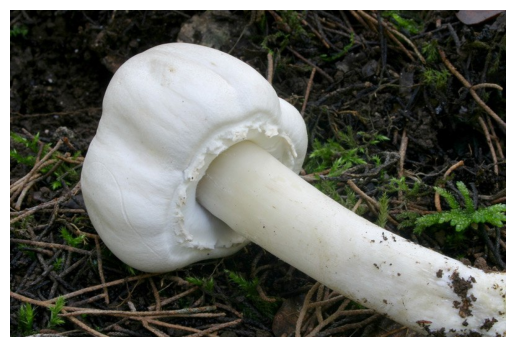

In [117]:
ls = os.listdir("Mushrooms/Agaricus")
img = Image.open('/content/Mushrooms/Agaricus/'+ ls[0])
plt.imshow(img)
plt.axis('off');

In [118]:
for image in ls[:15]:
  img = Image.open('/content/Mushrooms/Agaricus/'+ image)
  width, height = img.size
  print(f"Width: {width}, Height: {height}")

Width: 800, Height: 528
Width: 800, Height: 536
Width: 800, Height: 600
Width: 726, Height: 600
Width: 800, Height: 600
Width: 800, Height: 533
Width: 800, Height: 531
Width: 800, Height: 554
Width: 800, Height: 598
Width: 800, Height: 469
Width: 707, Height: 600
Width: 800, Height: 646
Width: 800, Height: 600
Width: 800, Height: 526
Width: 800, Height: 533


Images are colored, varies in width and in height.

In [93]:
random.seed(10)

def print_random_mushrooms(folder):
    """Prints random 8 pictures of the given mushroom type."""

    folder_path = os.path.join("Mushrooms/", folder)
    images = os.listdir(folder_path)

    selected_images = random.sample(images, min(len(images), 8))
    fig = plt.figure(figsize=(17, 8))
    fig.suptitle(folder, fontsize=16, fontweight='bold')

    for i, image in enumerate(selected_images):
        image_path = os.path.join(folder_path, image)
        img = Image.open(image_path)
        ax = fig.add_subplot(2, 4, i+1)
        ax.imshow(img)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

Describing the appearance characteristics of each mushroom type:

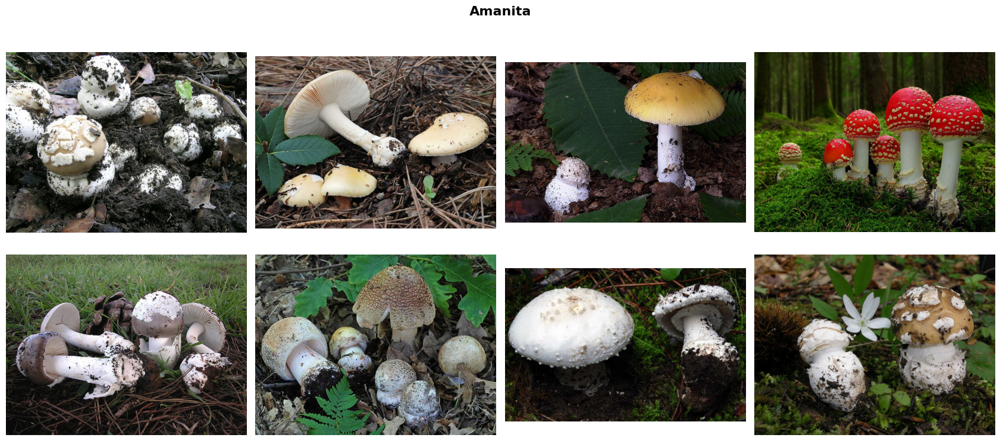

In [119]:
print_random_mushrooms(mushroom_folders[0])

* Color variations include white, brown, or red.
* The cap may have warts or patches.
* The gills are typically white.
* The stem features a ring.

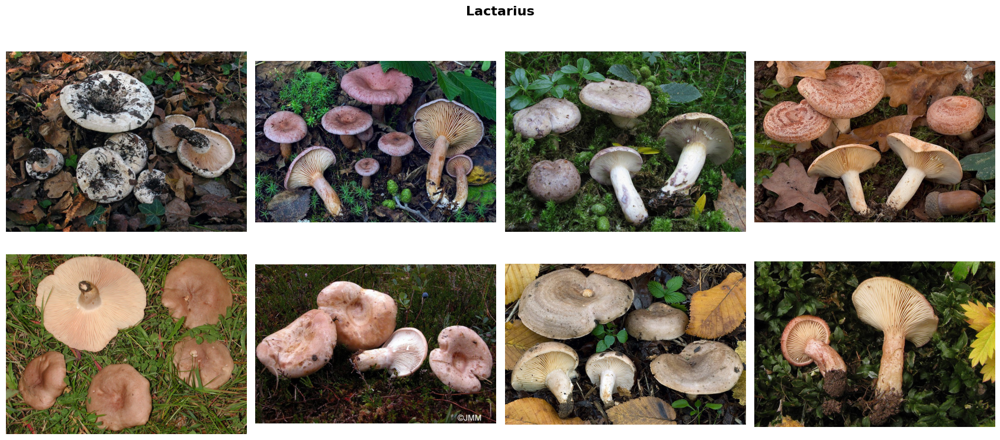

In [120]:
print_random_mushrooms(mushroom_folders[1])

* Exhibits colors ranging from orange to brown.
* The cap is wavy, often concave or convex in the center.
* Gills are attached directly to the stem.
* The stem's color usually matches the cap, though it can sometimes be a shade lighter.

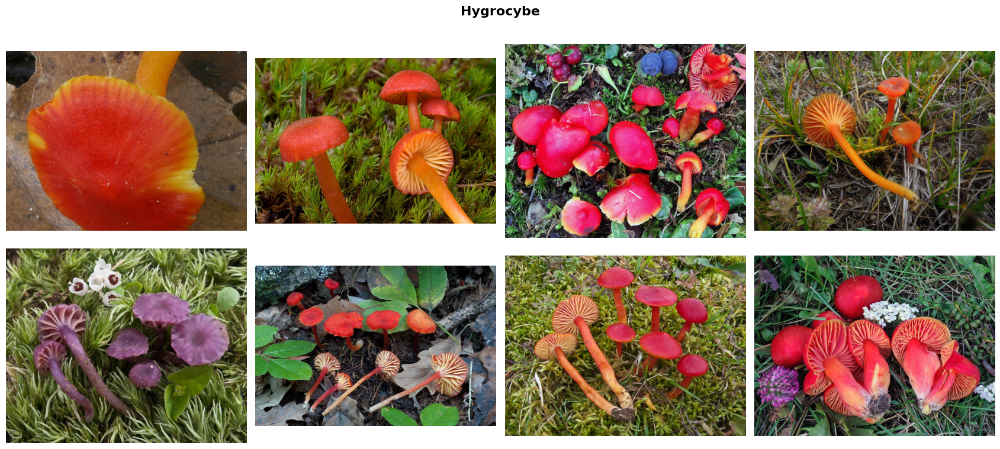

In [121]:
print_random_mushrooms(mushroom_folders[2])

* Boasts vibrant colors, including shades of red, orange, and violet.
* Features a notably slender stem in relation to the size of the cap.

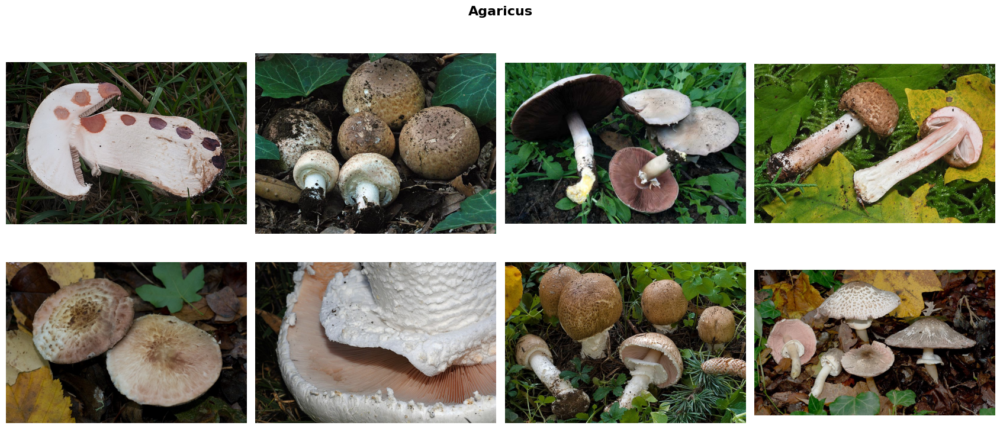

In [122]:
print_random_mushrooms(mushroom_folders[3])

* Exhibits colors like white, brown, or a yellowish hue.
* The cap frequently displays scales or fibrous patterns.
* Features a distinct ring encircling the stem.

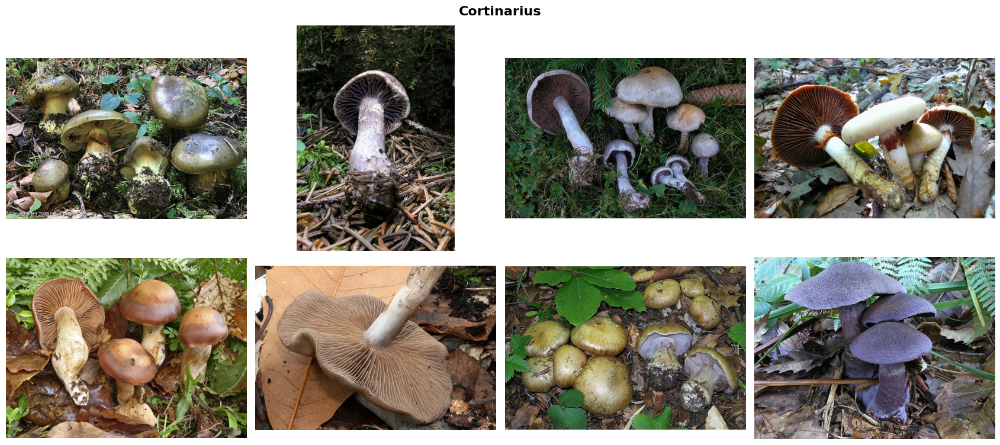

In [123]:
print_random_mushrooms(mushroom_folders[4])

* The cap displays an uncommon color, with the underside typically being brown instead of white.
* Features a cortina that shields the gills.
* The gills are densely packed and often exhibit a wavy pattern.

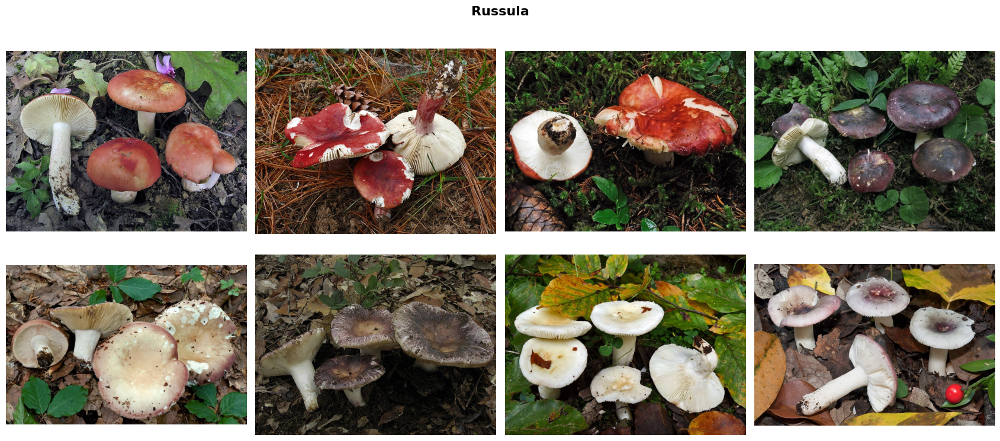

In [124]:
print_random_mushrooms(mushroom_folders[5])


* The cap is vibrantly colored, coming in shades of red, violet, white, and other bright hues. It often has a central depression or elevation.
* The gills are either free or minimally attached to the stem.
* Lacks a veil.

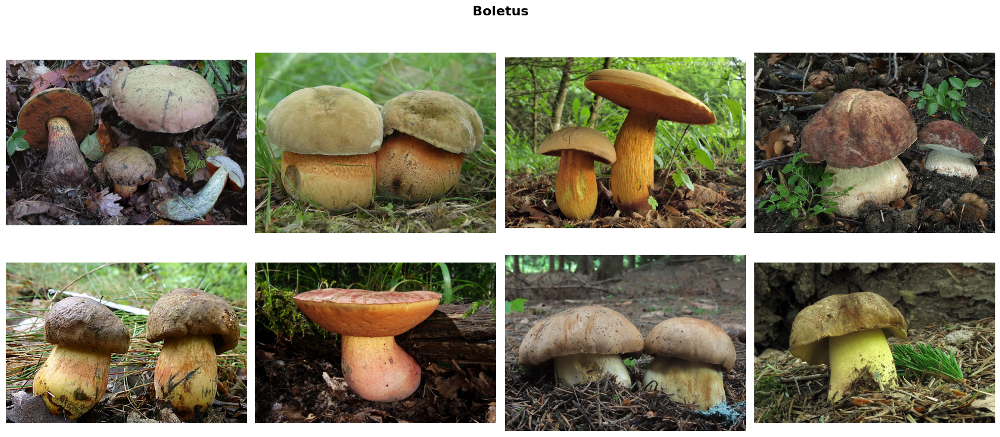

In [125]:
print_random_mushrooms(mushroom_folders[6])

* Initially convex in shape when young, but flattens as it matures.
* Features a notably thick stem, which often displays a distinctive pattern.
* Primarily brown in color, complemented by a lighter-hued stem.
* Instead of gills, it possesses pores on the cap's underside.

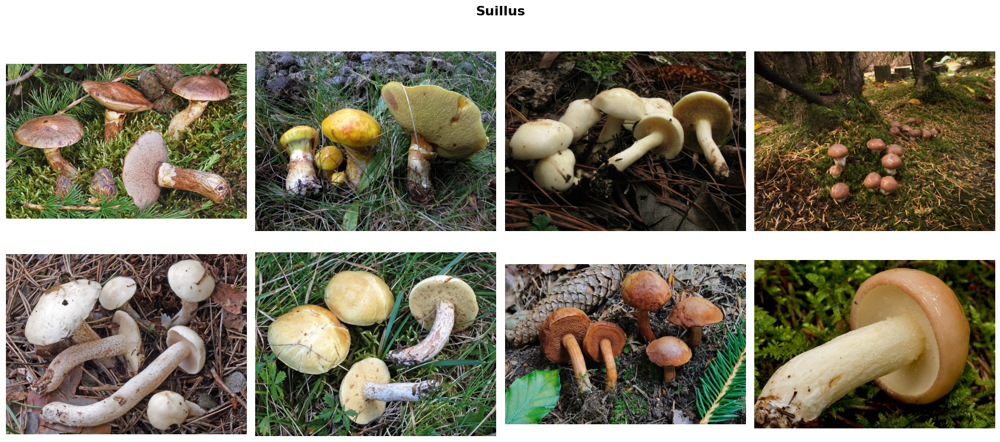

In [126]:
print_random_mushrooms(mushroom_folders[7])


* The cap is frequently slimy and can be brown, yellowish, or reddish in color.
* The stem showcases glandular dots.
* Instead of gills, the mushroom features pores on the cap's underside.

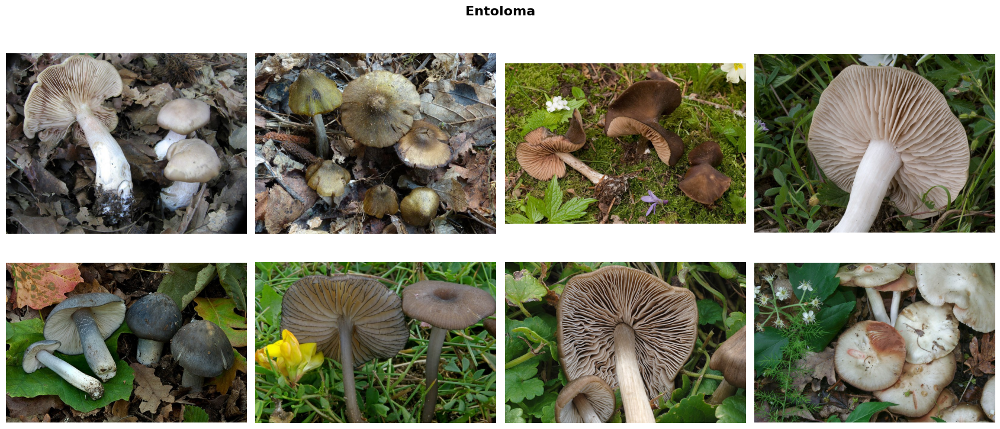

In [127]:
print_random_mushrooms(mushroom_folders[8])

* The gills are usually attached to the stem, often exhibiting a slight notch where they connect.
* The mushroom boasts a diverse color palette, including shades of white, gray, brown, yellowish, greenish, and blue.

In summary, mushroom types can be distinguished by several characteristics: the underside of the cap (whether it has gills or a spongy appearance), the color of both the cap's top and bottom as well as the stem, the presence of a skirt on the stem, the cap's shape, any spots on the cap, its sliminess, and the size of the stem.

## Model creation

In [43]:
ImageFile.LOAD_TRUNCATED_IMAGES = True
data = ImageDataLoaders.from_folder('Mushrooms',
                                    train=".",
                                    valid_pct=0.2,
                                    seed=42,
                                    item_tfms=Resize(460),
                                    batch_tfms=[*aug_transforms(size=224), Normalize.from_stats(*imagenet_stats)])

The data is loaded, image augmentation is applied.

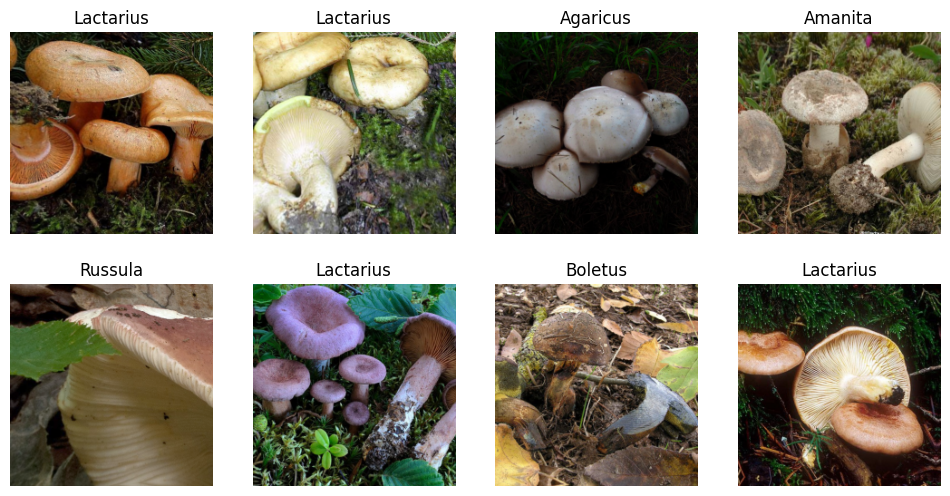

In [44]:
data.show_batch(nrows=2, ncols=4)

### resnet34

In [78]:
learn_resnet34 = vision_learner(data, resnet34, pretrained=True, metrics=[accuracy])
learn_resnet34.summary()

Sequential (Input shape: 64 x 3 x 224 x 224)
Layer (type)         Output Shape         Param #    Trainable 
                     64 x 64 x 112 x 112 
Conv2d                                    9408       False     
BatchNorm2d                               128        True      
ReLU                                                           
____________________________________________________________________________
                     64 x 64 x 56 x 56   
MaxPool2d                                                      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                                                           
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
Conv2d                                    36864      False     
BatchNorm2d                               128        True      
ReLU                      

SuggestedLRs(valley=0.0010000000474974513)

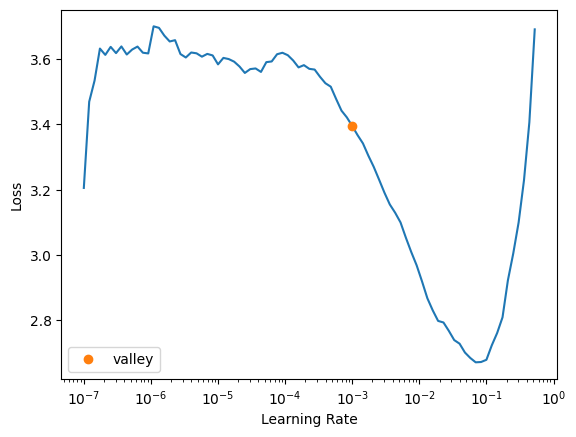

In [79]:
learn_resnet34.lr_find()

In [80]:
cbs = [EarlyStoppingCallback(monitor='valid_loss', min_delta=0.01, patience=3)]
learn_resnet34.fine_tune(epochs=20, base_lr=0.001, cbs=cbs)
learn_resnet34.export('resnet34.pkl')

epoch,train_loss,valid_loss,accuracy,time
0,2.128216,1.081444,0.662444,00:19


epoch,train_loss,valid_loss,accuracy,time
0,1.317844,0.875709,0.716841,00:21
1,1.088925,0.771256,0.748137,00:20
2,0.896662,0.665920,0.784650,00:21
3,0.697247,0.584260,0.814456,00:20
4,0.530535,0.545080,0.837556,00:20
5,0.399544,0.500148,0.845753,00:19
6,0.316164,0.487797,0.859165,00:20
7,0.242229,0.484892,0.863636,00:20
8,0.185707,0.502923,0.853949,00:20
9,0.153547,0.468221,0.858420,00:20


No improvement since epoch 15: early stopping


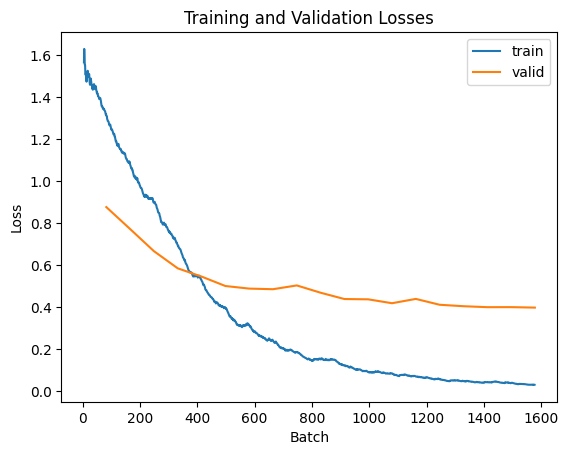

In [81]:
learn_resnet34.recorder.plot_loss()
plt.gca().set(xlabel='Batch', ylabel='Loss', title='Training and Validation Losses');

### resnet18

In [148]:
learn_resnet18 = vision_learner(data, resnet18, pretrained=True, metrics=[accuracy])
learn_resnet18.fine_tune(epochs=20, base_lr=0.001, cbs=cbs)
learn_resnet18.export('resnet18.pkl')

epoch,train_loss,valid_loss,accuracy,time
0,2.198830,1.138537,0.627422,00:19


epoch,train_loss,valid_loss,accuracy,time
0,1.396315,0.982111,0.672131,00:19
1,1.211867,0.879889,0.701937,00:19
2,1.021909,0.772540,0.740686,00:19
3,0.851688,0.680062,0.773472,00:19
4,0.715188,0.623381,0.796572,00:19
5,0.574904,0.568294,0.818927,00:20
6,0.432120,0.567487,0.829359,00:20
7,0.366243,0.525410,0.836811,00:20
8,0.282638,0.507773,0.841282,00:19
9,0.249427,0.484625,0.856930,00:19


No improvement since epoch 12: early stopping


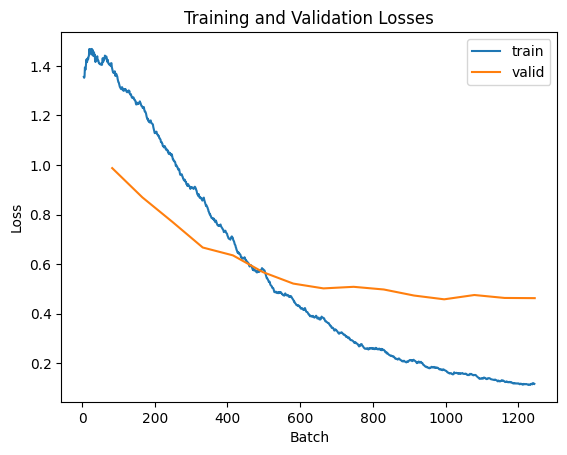

In [135]:
learn_resnet18.recorder.plot_loss()
plt.gca().set(xlabel='Batch', ylabel='Loss', title='Training and Validation Losses');

### resnet50

In [99]:
learn_resnet50 = vision_learner(data, resnet50, pretrained=True, metrics=[accuracy])
learn_resnet50.fine_tune(epochs=20, base_lr=0.001, cbs=cbs)
learn_resnet50.export('resnet50.pkl')

epoch,train_loss,valid_loss,accuracy,time
0,1.753118,1.023093,0.690760,00:22


epoch,train_loss,valid_loss,accuracy,time
0,0.991875,0.731350,0.769747,00:25
1,0.779710,0.585958,0.809240,00:25
2,0.612709,0.508013,0.833830,00:25
3,0.457390,0.467533,0.850969,00:25
4,0.357555,0.454718,0.853949,00:25
5,0.269993,0.437148,0.874814,00:25
6,0.195406,0.380679,0.892697,00:25
7,0.164638,0.379631,0.891952,00:25
8,0.116828,0.382154,0.895678,00:25
9,0.106977,0.348521,0.906855,00:24


No improvement since epoch 9: early stopping


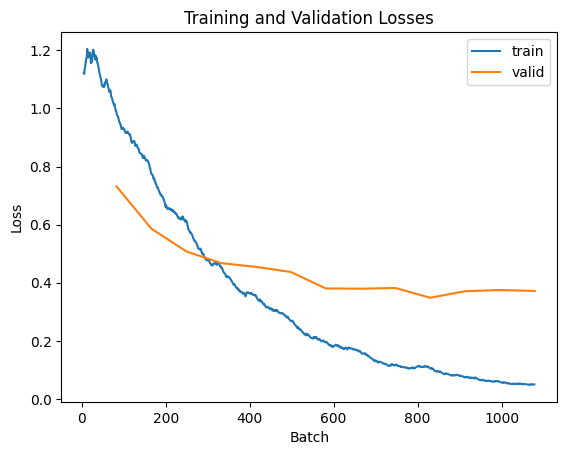

In [100]:
learn_resnet50.recorder.plot_loss()
plt.gca().set(xlabel='Batch', ylabel='Loss', title='Training and Validation Losses');

### densenet121

In [121]:
learn_densenet121 = vision_learner(data, densenet121, pretrained=True, metrics=[accuracy])
learn_densenet121.fine_tune(epochs=20, base_lr=0.0008, cbs=cbs)
learn_densenet121.export('densenet121.pkl')

epoch,train_loss,valid_loss,accuracy,time
0,1.931233,0.936791,0.685544,00:24


epoch,train_loss,valid_loss,accuracy,time
0,1.157883,0.788894,0.738450,00:29
1,1.001909,0.687588,0.763785,00:28
2,0.854129,0.624824,0.798808,00:28
3,0.714942,0.530304,0.819672,00:28
4,0.584843,0.471790,0.851714,00:28
5,0.488458,0.423500,0.862891,00:28
6,0.385071,0.392107,0.877794,00:28
7,0.311268,0.371432,0.874814,00:28
8,0.270633,0.345462,0.894188,00:28
9,0.201542,0.347111,0.895678,00:28


No improvement since epoch 12: early stopping


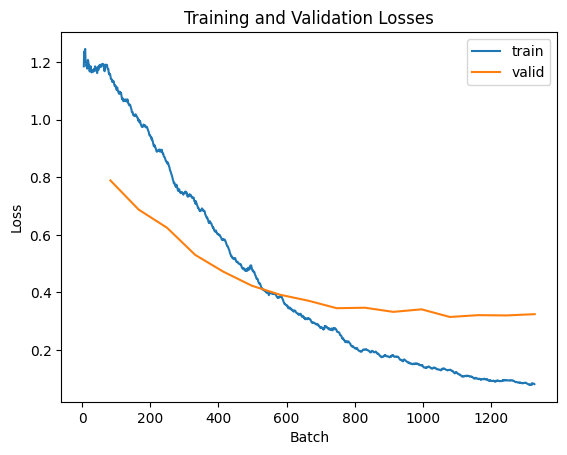

In [122]:
learn_densenet121.recorder.plot_loss()
plt.gca().set(xlabel='Batch', ylabel='Loss', title='Training and Validation Losses');

### efficientnet_b0

In [145]:
learn_efficientnet_b0 = vision_learner(data, efficientnet_b0, pretrained=True, metrics=[accuracy])
learn_efficientnet_b0.fine_tune(epochs=20, base_lr=0.0008, cbs=cbs)
learn_efficientnet_b0.export('efficientnet_b0.pkl')

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-3dd342df.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-3dd342df.pth
100%|██████████| 20.5M/20.5M [00:02<00:00, 9.66MB/s]


epoch,train_loss,valid_loss,accuracy,time
0,2.256641,1.180397,0.619970,00:20


epoch,train_loss,valid_loss,accuracy,time
0,1.553056,1.078296,0.653502,00:21
1,1.454621,1.005422,0.677347,00:21
2,1.349250,0.948129,0.685544,00:21
3,1.250801,0.914031,0.698957,00:21
4,1.187955,0.865454,0.716841,00:21
5,1.061821,0.795037,0.729508,00:21
6,0.981454,0.756744,0.751863,00:21
7,0.926336,0.730214,0.741431,00:21
8,0.846571,0.736228,0.750373,00:21
9,0.766934,0.693251,0.759314,00:22


No improvement since epoch 16: early stopping


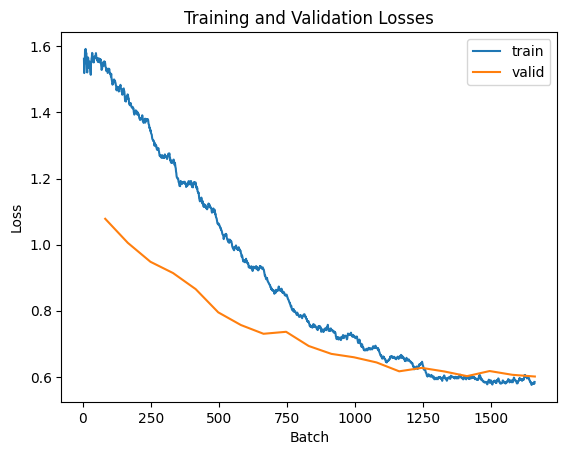

In [149]:
learn_efficientnet_b0.recorder.plot_loss()
plt.gca().set(xlabel='Batch', ylabel='Loss', title='Training and Validation Losses');

## Model comparison and evaluation

In [157]:
model_accuracies = {
    'resnet18': np.round(learn_resnet18.recorder.values[-1][2], 3),
    'resnet34': np.round(learn_resnet34.recorder.values[-1][1], 3),
    'resnet50': np.round(learn_resnet50.recorder.values[-1][1], 3),
    'densenet121': np.round(learn_densenet121.recorder.values[-1][1], 3),
    'efficientnet_b0': np.round(learn_efficientnet_b0.recorder.values[-1][2], 3)
}

In [159]:
interp_resnet18 = ClassificationInterpretation.from_learner(learn_resnet18)
interp_resnet34 = ClassificationInterpretation.from_learner(learn_resnet34)
interp_resnet50 = ClassificationInterpretation.from_learner(learn_resnet50)
interp_densenet121 = ClassificationInterpretation.from_learner(learn_densenet121)
interp_efficientnet_b0 = ClassificationInterpretation.from_learner(learn_efficientnet_b0)

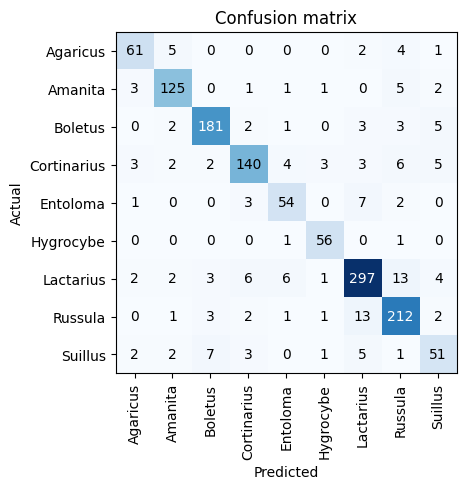

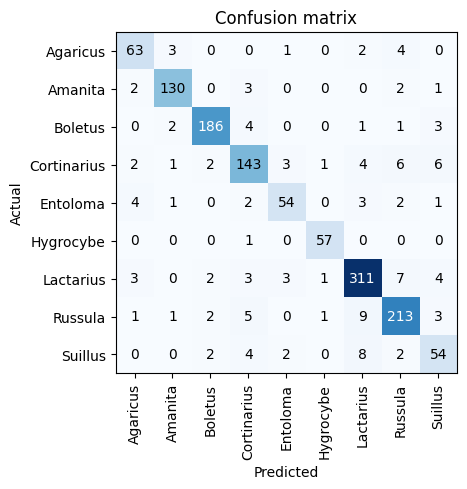

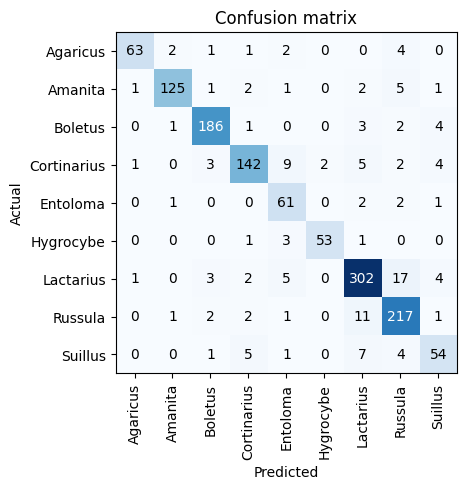

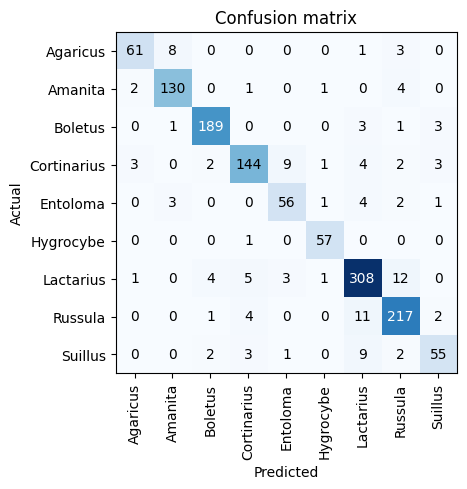

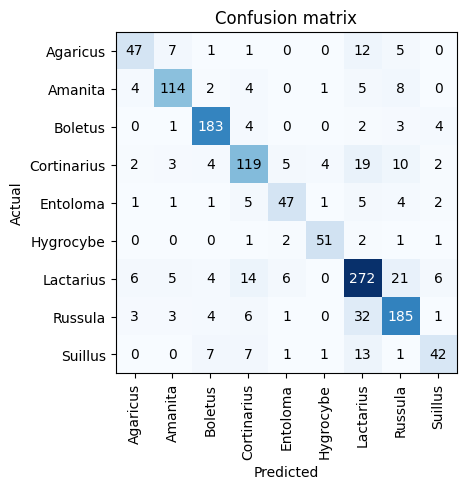

In [160]:
interp_resnet18.plot_confusion_matrix()
interp_resnet34.plot_confusion_matrix()
interp_resnet50.plot_confusion_matrix()
interp_densenet121.plot_confusion_matrix()
interp_efficientnet_b0.plot_confusion_matrix()

All models are struggling the most to differ Russula and Lactarius.

Comparing models accuracies and time inference:

In [188]:
def measure_prediction_time(model, model_name, image):
    """Measures time to make one prediction and returns inference time and predicted type."""
    start_time = time.time()
    pred = model.predict(image)
    end_time = time.time()
    elapsed_time = end_time - start_time

    return elapsed_time, pred[0]

In [190]:
img = PILImage.create('Russula test.jpg')
model_data = []
for model, name in [(learn_resnet18, 'resnet18'),
                    (learn_resnet34, 'resnet34'),
                    (learn_resnet50, 'resnet50'),
                    (learn_densenet121, 'densenet121'),
                    (learn_efficientnet_b0, 'efficientnet_b0')]:

    inference_time, prediction = measure_prediction_time(model, name, img)
    accuracy = model_accuracies[name]

    model_data.append([name, inference_time, accuracy, prediction])

df = pd.DataFrame(model_data, columns=['Model', 'Inference Time', 'Accuracy', 'Predicted Type'])
df

,Model,Inference Time,Accuracy,Predicted Type
0,resnet18,0.071199,0.877,Russula
1,resnet34,0.070316,0.902,Russula
2,resnet50,0.077505,0.896,Russula
3,densenet121,0.087352,0.907,Russula
4,efficientnet_b0,0.079221,0.790,Russula


The models have comparable performance, with all correctly predicting the test image. The highest accuracy is achieved by `densenet121`, followed closely by `resnet18`. Given that `resnet18` boasts a marginally better inference time, I would select it as the optimal choice.

Example of `resnet34` predictions:

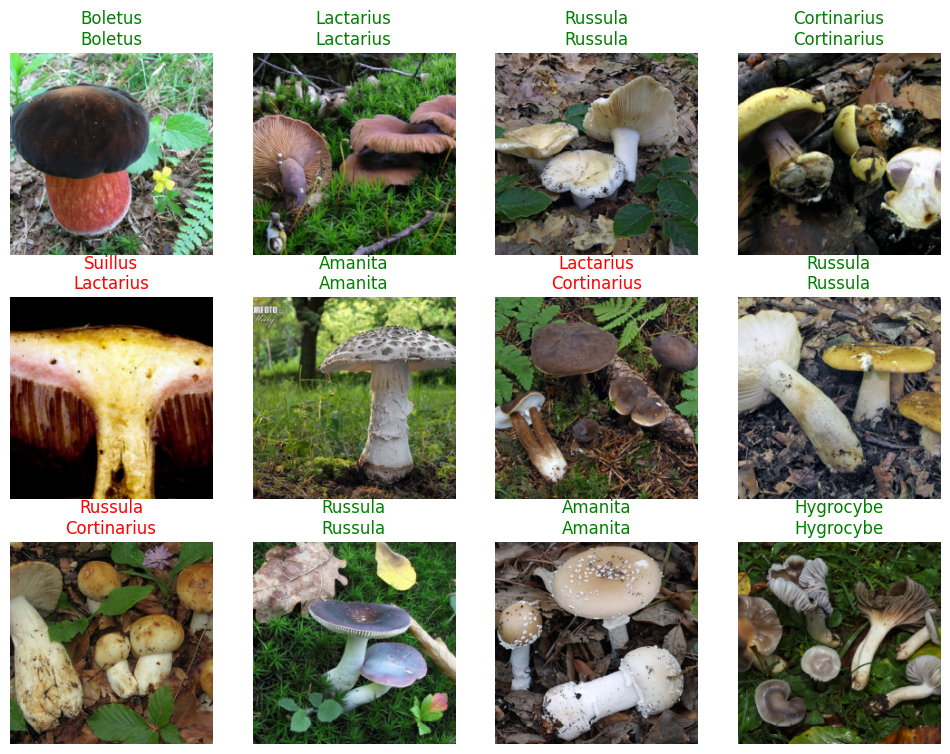

In [194]:
learn_resnet34.show_results(max_n=12, nrows=3, ncols=4)

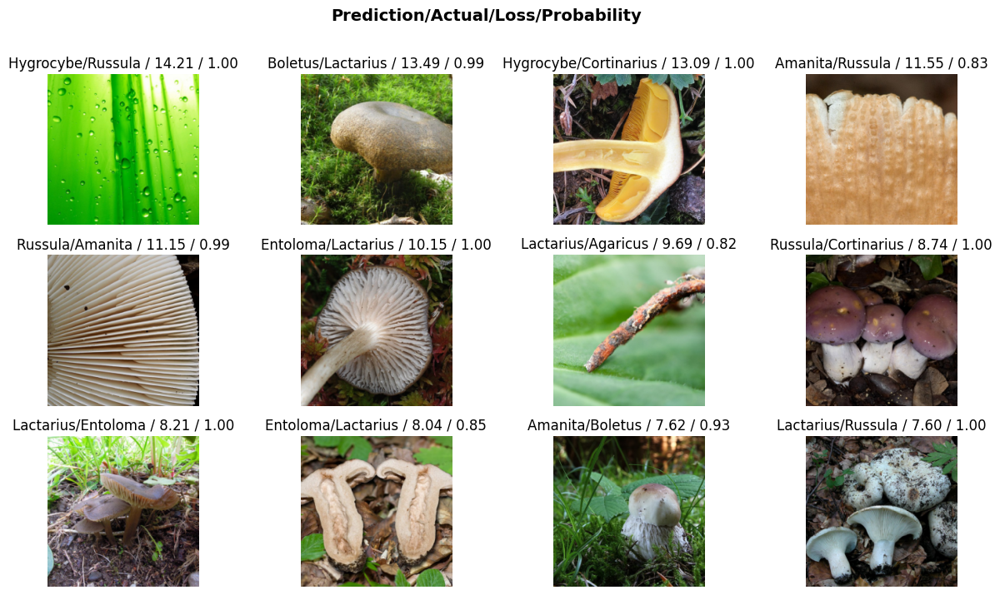

In [191]:
interp_resnet34.plot_top_losses(12, figsize=(15,8))

This model struggled to predict correctly where only part of mushroom is missing, also few images that were predicted incorrectly were not of mushroom, so can be disregarded.

## Summary
* The top-performing models were resnet34 and densenet121, each achieving an accuracy of 90%. The prediction time for both models ranged between 0.07 to 0.08 seconds.

### Recommendations for Improvement
* The dataset should be scrutinized to eliminate images that don't feature mushrooms.
* Additional pictures of mushrooms could be incorporated into the dataset.
* As more data becomes available, more advanced pre-trained models could be employed.
* A score indicating the model's confidence could be displayed.